In [0]:
import numpy as np
import functools
import copy
import matplotlib.pyplot as plt
from matplotlib import animation
from scipy import signal
import itertools
from IPython import display
import pandas as pd
import seaborn as sns
from scipy import stats
import collections
from concurrent import futures

Los sistemas auto-organizados presentan multiples propiedades interesantes que vale la pena tratar de conocer y explorarlas. Las pilas de arena y avalanchas(fenomenos naturales) presentas estas propiedades y se intentara simular este modelo a fin de conocer el comportamiento. (En colaboracion)

In [0]:
w = np.array([
    [0.0, 1.0, 0.0],
    [1.0, -4.0, 1.0],
    [0.0, 1.0, 0.0]
    ])

In [0]:
nivel = 0
n,m = 5,5
A = np.ones((n, m), dtype=np.float64) * nivel

In [0]:
A[1, 1] = 4
A[1, 3] = 4

In [0]:
A

array([[0., 0., 0., 0., 0.],
       [0., 4., 0., 4., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.]])

In [0]:
caer = 3
cayendo = A>caer

In [0]:
cayendo

array([[False, False, False, False, False],
       [False,  True, False,  True, False],
       [False, False, False, False, False]])

In [0]:
num_caidas = np.sum(cayendo)

In [0]:
num_caidas

2

In [0]:
c = signal.correlate2d(cayendo, w, mode='same' )

In [0]:
c

array([[ 0.,  1.,  0.,  1.,  0.],
       [ 1., -4.,  2., -4.,  1.],
       [ 0.,  1.,  0.,  1.,  0.]])

In [0]:
A += c

In [0]:
A

array([[0., 1., 0., 1., 0.],
       [1., 0., 2., 0., 1.],
       [0., 1., 0., 1., 0.]])

In [0]:
w = np.array([
    [0.0, 1.0, 0.0],
    [1.0, -4.0, 1.0],
    [0.0, 1.0, 0.0]
    ])

def inicializar(n, m, nivel):
    A = np.ones((n, m), dtype=np.float64) * nivel
    return A
  
def actualizacion(A, w, critico):
    
    cayendo = A > critico
    num_caidas = np.sum(cayendo)
    c = signal.correlate2d(cayendo, w, mode='same' )
    A += c
    return A #num_caidas

In [0]:
def simulacion(A, w, critico):    
    total = 0
    for i in itertools.count(1):
        num_caidos = actualizacion(A, w, critico)
        total += num_caidos
        if num_caidos == 0:
            return i, total

In [0]:
A = inicializar(80, 80, 10)
#simulacion(A, w, 2)

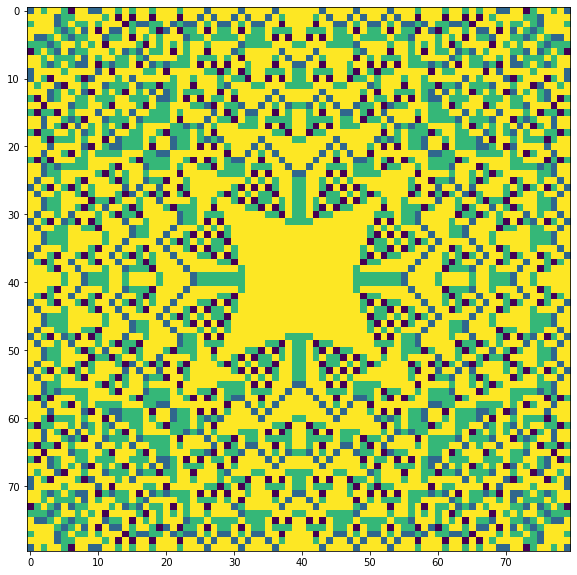

In [0]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(A)

In [0]:
def actualizar_animacion(i):
    global A
    A = actualizacion(A, w, critico)
    imagen.set_array(A)
    return imagen

#print(A.shape)
#actualizar_animacion(1)
#print(A.shape)
#print(actualizar_animacion(1))
imagen = ax.imshow(A)


In [0]:
anim = animation.FuncAnimation(fig, actualizar_animacion, frames=2*n-1, interval=1000/24)

In [0]:
#display.display_html(anim.to_jshtml(), raw=True)

# Simulacion animada

Animation size has reached 20989299 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Once 
 
 Loop 
 
 Reflect

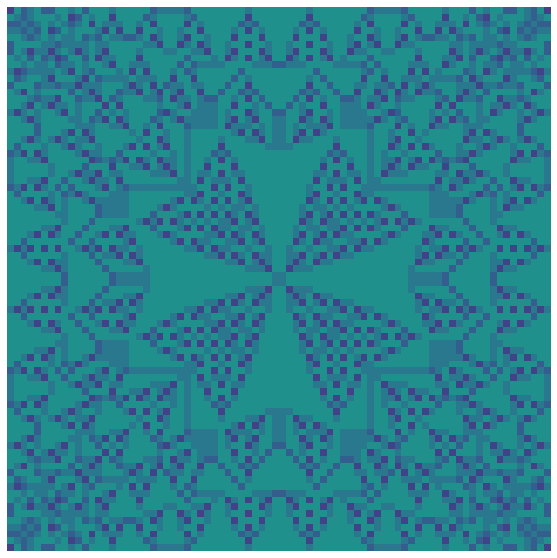

In [0]:
w = np.array([
    [0.0, 1.0, 0.0],
    [1.0, -4.0, 1.0],
    [0.0, 1.0, 0.0]
    ])

critico = 5

def inicializar(n, m, nivel):
    A = np.ones((n, m), dtype=np.float64) * nivel
    return A
  
def actualizacion(A, w, critico):
    
    cayendo = A > critico
    num_caidas = np.sum(cayendo)
    c = signal.correlate2d(cayendo, w, mode='same' )
    A += c
    return A #num_caidas

def simulacion(A, w, critico):    
    total = 0
    for i in itertools.count(1):
        num_caidos = actualizacion(A, w, critico)
        total += num_caidos
        if num_caidos == 0:
            return i, total
        
        
        
A = inicializar(80, 80, 10)
#simulacion(A, w, 2)

def actualizar_animacion(i):
    global A
    A = actualizacion(A, w, critico)
    imagen.set_array(A)
    return imagen

#print(A.shape)
#actualizar_animacion(1)
#print(A.shape)
#print(actualizar_animacion(1))
fig, ax = plt.subplots(figsize=(10, 10))
#print(A)
imagen = ax.imshow(A, vmin=0, vmax=10)
ax.set_axis_off()
anim = animation.FuncAnimation(fig, actualizar_animacion, frames=5000, interval=1000/24)
display.display_html(anim.to_jshtml(), raw=True)

In [0]:
w = np.array([
    [0.0, 1.0, 0.0],
    [1.0, -4.0, 1.0],
    [0.0, 1.0, 0.0]
    ])

critico = 3

def inicializar(n, m, nivel):
    A = np.ones((n, m), dtype=np.float64) * nivel
    return A

def actualizacion(A, w, critico):
    
    cayendo = A > critico
    num_caidas = np.sum(cayendo)
    c = signal.correlate2d(cayendo, w, mode='same' )
    A += c
    return num_caidas

def simulacion(A, w, critico):    
    total = 0
    for i in itertools.count(1):
        num_caidos = actualizacion(A, w, critico)
        total += num_caidos
        if num_caidos == 0:
            return i, total
        
A = inicializar(50, 50, 30)

def tirar(A):
    a, b = A.shape
    n, m = np.random.randint(a), np.random.randint(b)
    A[n,m] += 1 
    return A

def tirar_correr():
    global A
    A = tirar(A)
    return simulacion(A, w, critico)
    
iters = 100000
res = [tirar_correr() for _ in range(iters)]

In [0]:
T, S = np.transpose(res)

In [0]:
S = S[S>0] # Al menos una avalancha
T = T[T>1] # Al menos dos pasos

In [0]:
def funcion_masa_probabilidad(W):
    w = collections.Counter(W)
    ite = w.items()
    orde = sorted(ite)
    x, y = zip(*orde)
    y = np.array(y)/sum(y)
    return x, y

(0, 50)

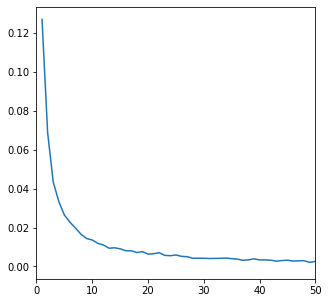

In [0]:
x, y = funcion_masa_probabilidad(S)
fig, ax = plt.subplots(figsize=(5, 5))
ax.plot(x,y)
ax.set_xlim(0,50)
#ax.set_xscale('log')
#ax.set_yscale('log')

(0, 50)

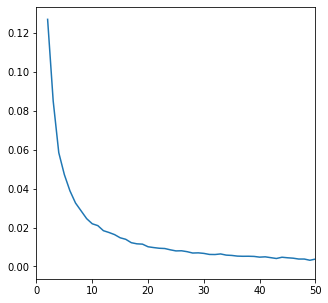

In [0]:
x, y = funcion_masa_probabilidad(T)
fig, ax = plt.subplots(figsize=(5, 5))
ax.plot(x,y)
ax.set_xlim(0,50)
#ax.set_xscale('log')
#ax.set_yscale('log')